<a href="https://colab.research.google.com/github/jiyoungeeeeeeeeeeeeeeeeeeeee/twitter_psychopath/blob/main/EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [31]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [32]:
import pandas as pd
import matplotlib.pyplot as plt
import math
import seaborn as sns
import numpy as np
from scipy.stats import zscore, spearmanr , shapiro
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, mean_squared_log_error
from sklearn.feature_selection import mutual_info_regression
from sklearn.preprocessing import MinMaxScaler , RobustScaler , StandardScaler
from sklearn.decomposition import PCA
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from sklearn.inspection import permutation_importance

In [33]:
data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/psychopath_data/PersonalityData_ExternalVersion001.csv')

In [34]:
pd.set_option('display.max_columns', None)  # 열 전체 출력 가능하게 설정
data.info(verbose=True , show_counts = True )

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2927 entries, 0 to 2926
Data columns (total 109 columns):
 #    Column             Non-Null Count  Dtype  
---   ------             --------------  -----  
 0    uid                2927 non-null   int64  
 1    psychopathy        2927 non-null   float64
 2    machiavellianism   2927 non-null   float64
 3    narcissism         2927 non-null   float64
 4    openness           2927 non-null   float64
 5    conscientiousness  2927 non-null   float64
 6    extraversion       2927 non-null   float64
 7    agreeableness      2927 non-null   float64
 8    neuroticism        2927 non-null   float64
 9    Var1               2593 non-null   float64
 10   Var2               2614 non-null   float64
 11   Var3               2614 non-null   float64
 12   Var4               2614 non-null   float64
 13   Var5               2614 non-null   float64
 14   Var6               2614 non-null   float64
 15   Var7               2614 non-null   float64
 16   Var8

In [35]:
data['Var20'] = pd.to_numeric(data['Var20'] , errors = 'coerce')
data = data.drop(['uid'] , axis = 1)

In [36]:
import plotly.express as px

data.describe().T\
    .style.bar(subset=['mean'], color=px.colors.qualitative.G10[2])\
    .background_gradient(subset=['std'], cmap='Blues')\
    .background_gradient(subset=['50%'], cmap='BuGn')

,count,mean,std,min,25%,50%,75%,max
psychopathy,2927.000000,1.975819,0.590817,1.000000,1.555556,1.888889,2.333333,4.666667
machiavellianism,2927.000000,2.792552,0.601120,1.000000,2.400000,2.800000,3.200000,5.000000
narcissism,2927.000000,2.726645,0.611013,1.000000,2.333333,2.777778,3.111111,4.777778
openness,2927.000000,5.510420,1.096339,1.000000,5.000000,5.500000,6.500000,7.000000
conscientiousness,2927.000000,4.674411,1.389679,1.000000,3.500000,4.500000,6.000000,7.000000
extraversion,2927.000000,4.090707,1.616798,1.000000,3.000000,4.000000,5.500000,7.000000
agreeableness,2927.000000,4.726341,1.211883,1.000000,4.000000,4.500000,5.500000,7.000000
neuroticism,2927.000000,3.688931,1.512482,1.000000,2.500000,3.500000,5.000000,7.000000
Var1,2593.000000,26.023351,13.078465,10.000000,13.960000,23.670000,36.960000,69.860000
Var2,2614.000000,0.376435,1.847992,0.000000,0.000000,0.000000,0.000000,20.000000


In [37]:
def summary(df):
    sum = pd.DataFrame(df.dtypes, columns=['dtypes'])
    sum['결측치 개수'] = df.isna().sum()
    sum['결측치 비율'] = (df.isna().sum())/len(df)
    sum['고유값 개수'] = df.nunique().values
    sum['데이터 개수'] = df.count().values


    return sum

summary(data).style.background_gradient(cmap='Blues')

,dtypes,결측치 개수,결측치 비율,고유값 개수,데이터 개수
psychopathy,float64,0,0.000000,33,2927
machiavellianism,float64,0,0.000000,39,2927
narcissism,float64,0,0.000000,35,2927
openness,float64,0,0.000000,13,2927
conscientiousness,float64,0,0.000000,13,2927
extraversion,float64,0,0.000000,13,2927
agreeableness,float64,0,0.000000,13,2927
neuroticism,float64,0,0.000000,13,2927
Var1,float64,334,0.114110,1822,2593
Var2,float64,313,0.106935,21,2614


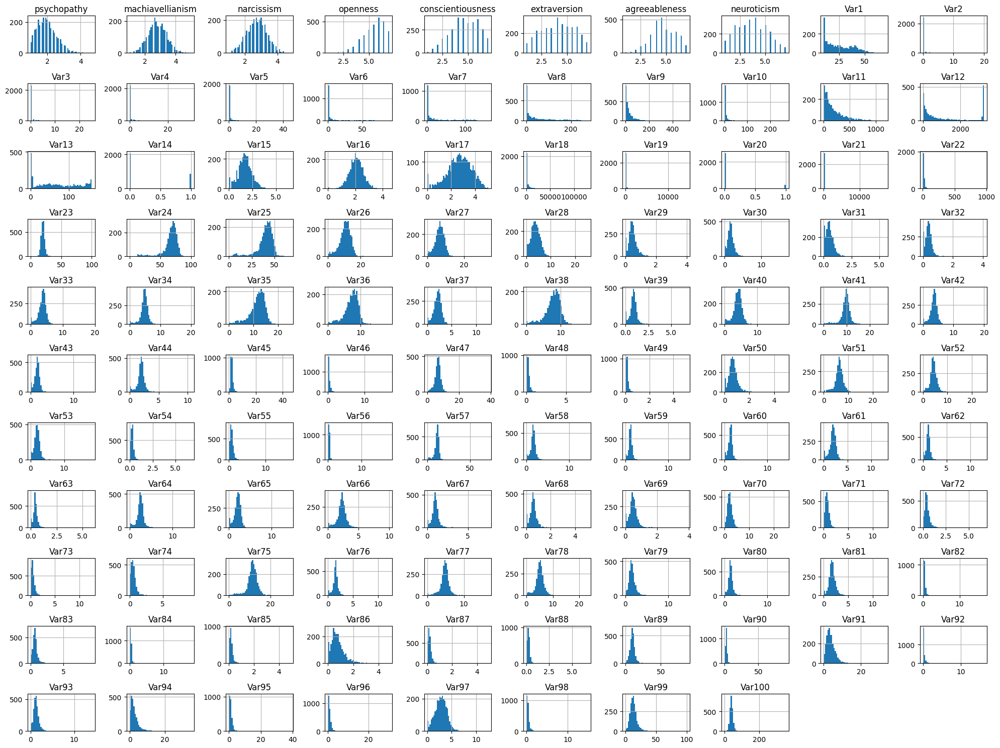

In [38]:
import matplotlib.pyplot as plt
import seaborn as sns

data.hist(
    bins=50,
    figsize=(20, 15),

)
plt.tight_layout()
plt.show()

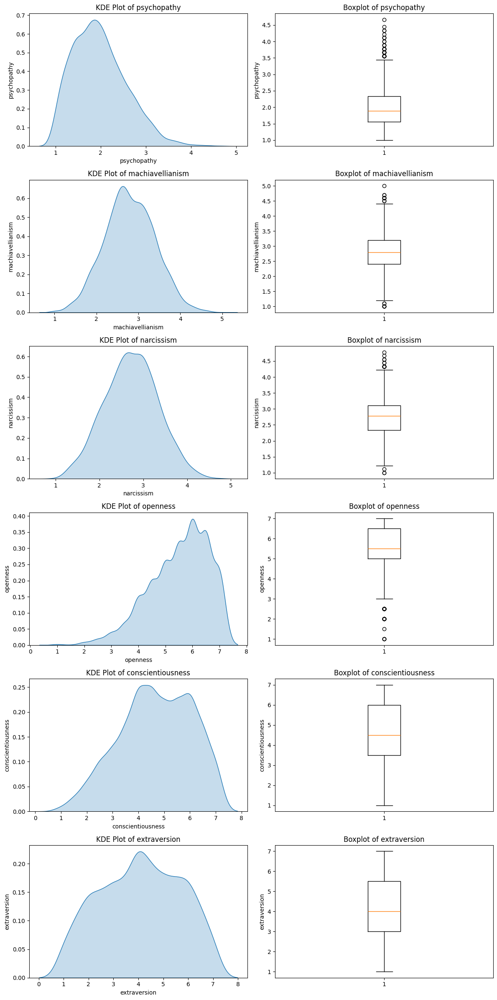

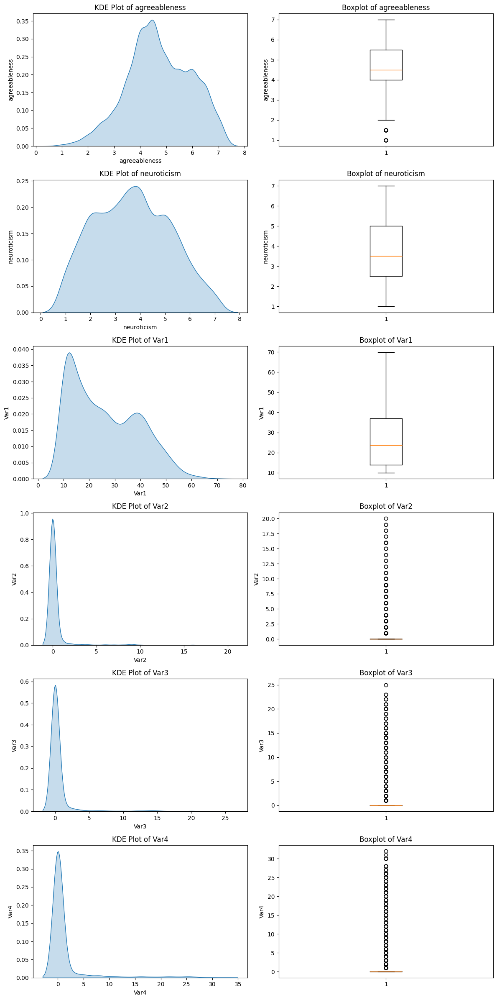

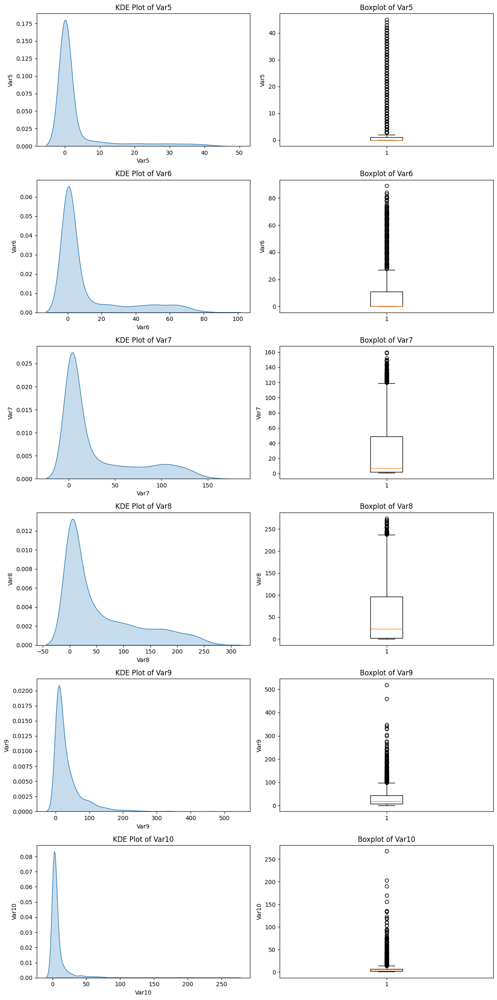

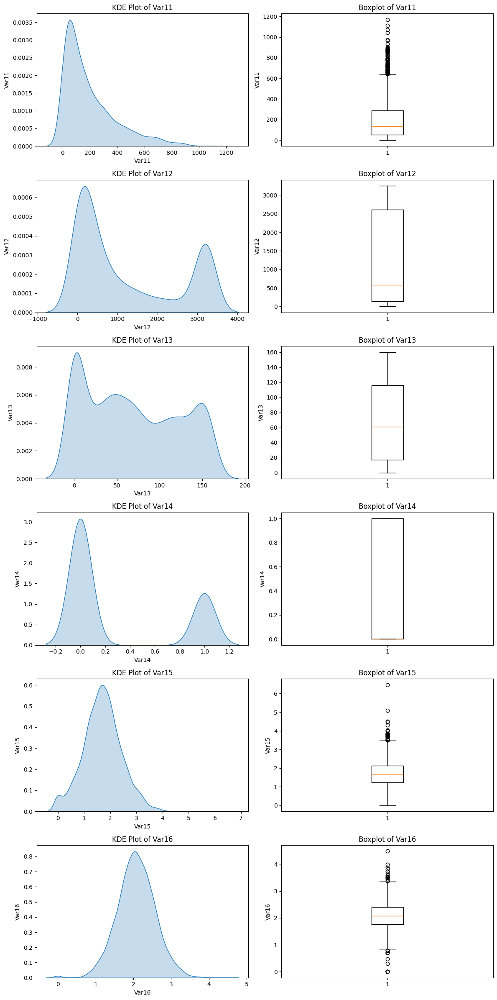

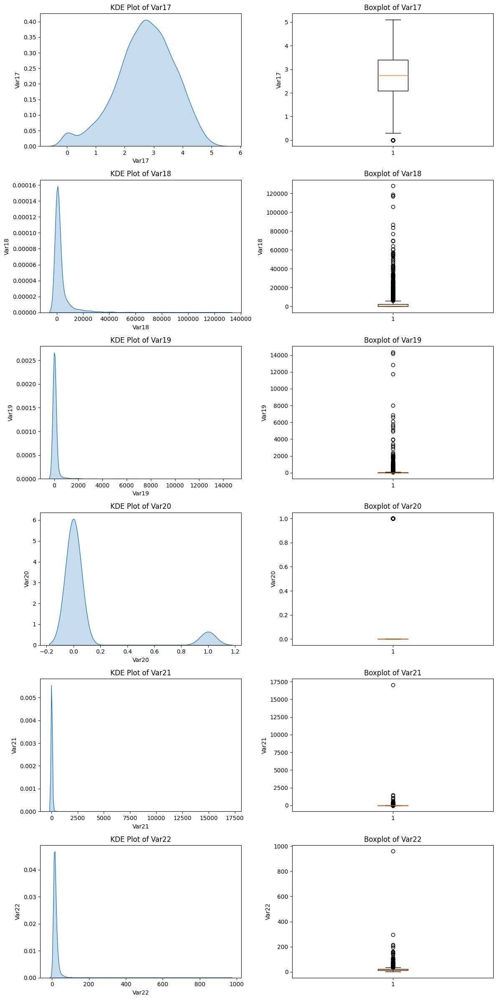

...

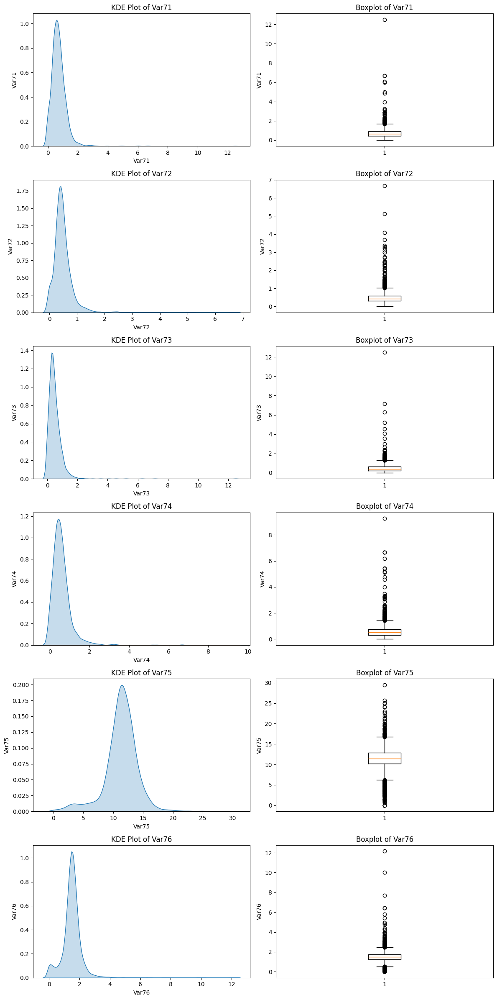

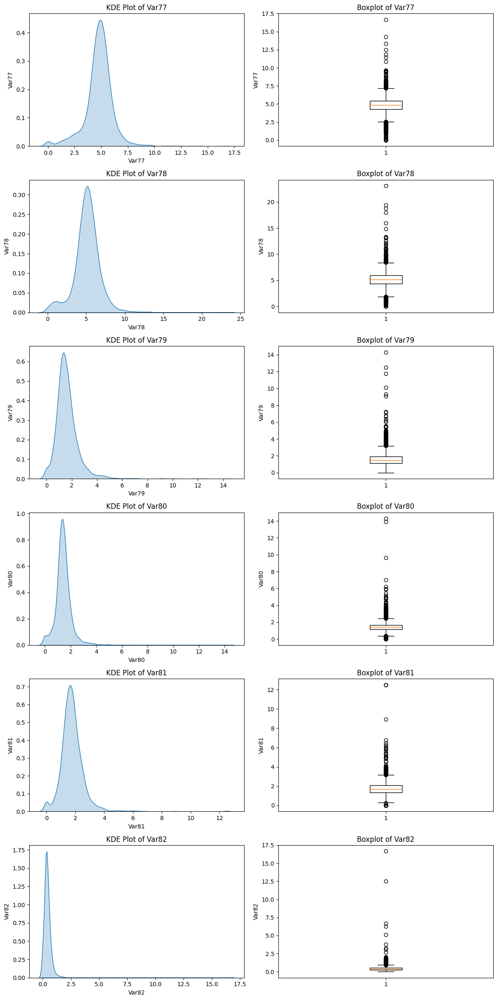

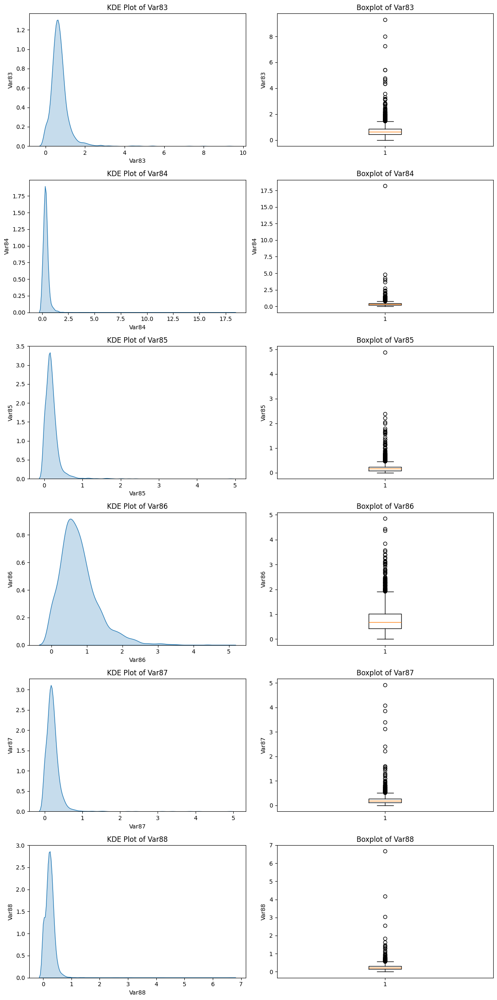

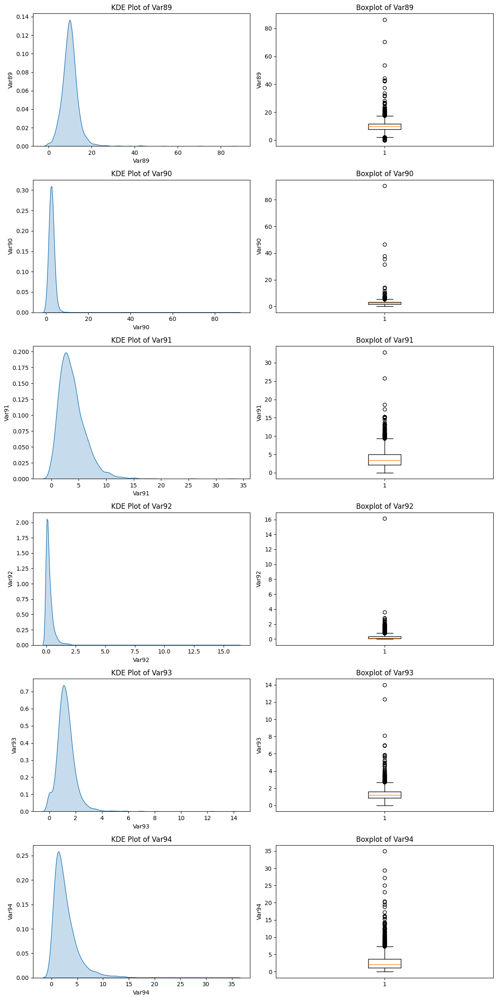

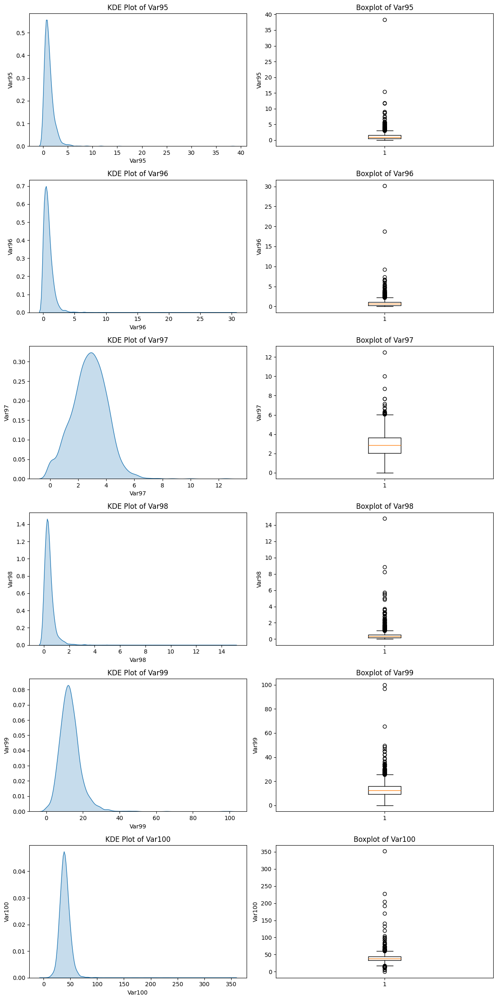

In [40]:
cols = data.columns
cols_per_page = 6  # 한 페이지당 시각화할 변수 개수
num_pages = math.ceil(len(cols) / cols_per_page)

for i in range(num_pages):
    subset_cols = cols[i * cols_per_page : (i + 1) * cols_per_page]
    num_plots = len(subset_cols)

    fig, axs = plt.subplots(nrows=num_plots, ncols=2, figsize=(12, 4 * num_plots))

    if num_plots == 1:
        axs = [axs]  # 1개일 경우 [[ax1, ax2]] 형태로 변환

    for j, col in enumerate(subset_cols):
        sns.kdeplot(data[col].dropna(), ax=axs[j][0], fill=True)
        axs[j][0].set_title(f'KDE Plot of {col}')
        axs[j][0].set_ylabel(col)

        axs[j][1].boxplot(data[col].dropna())
        axs[j][1].set_title(f'Boxplot of {col}')
        axs[j][1].set_ylabel(col)

    plt.tight_layout()
    plt.show()


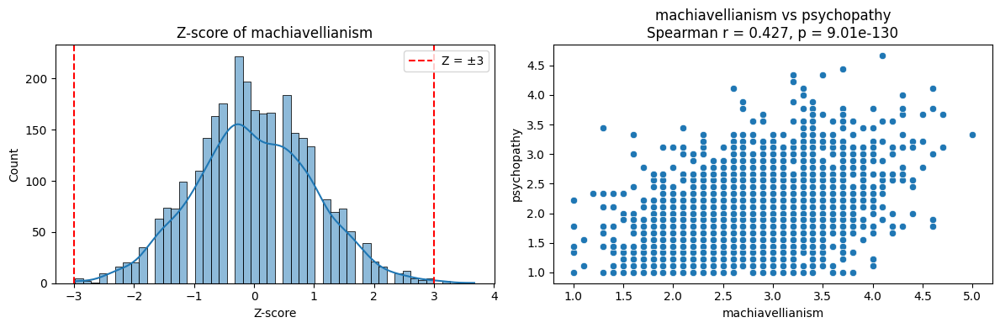

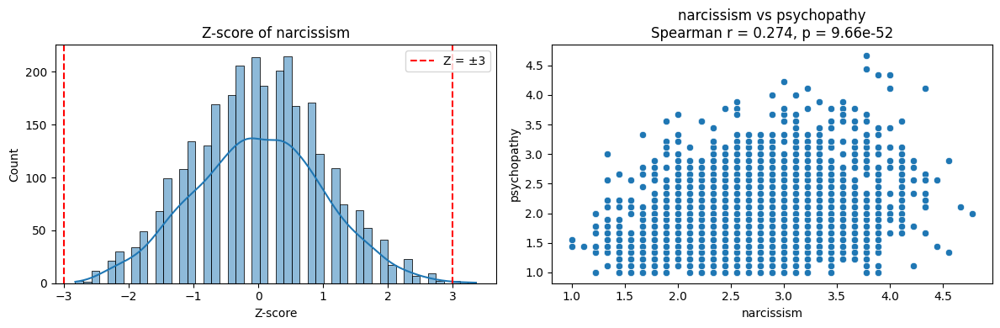

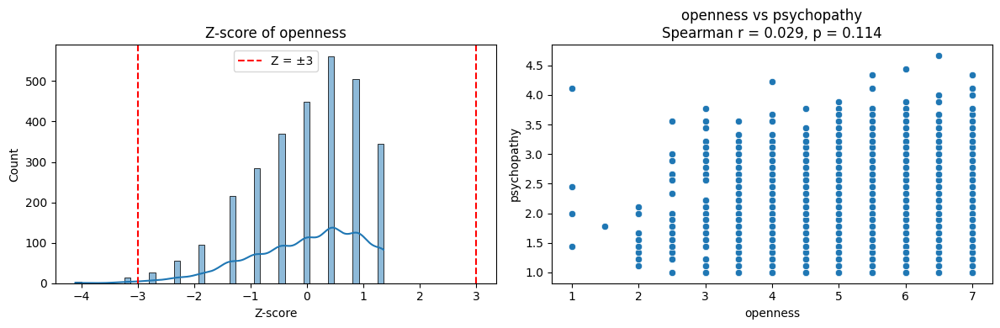

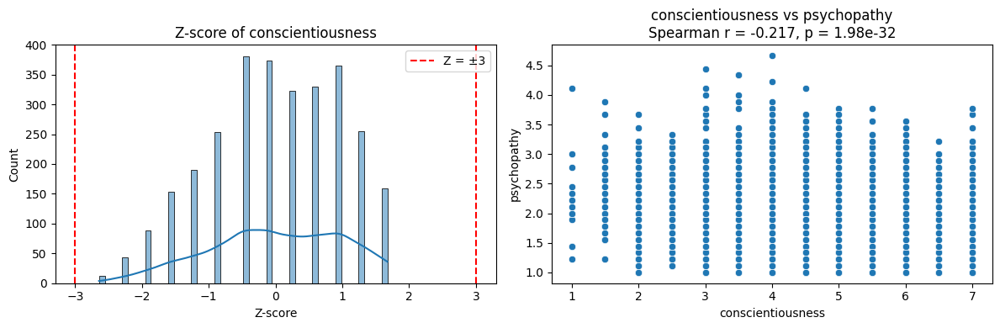

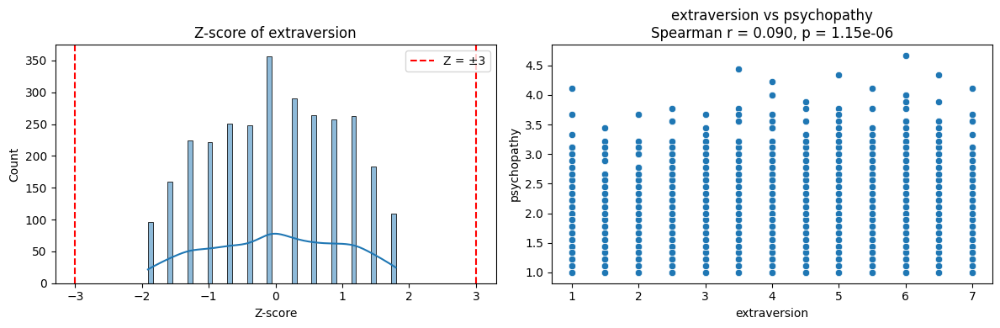

...

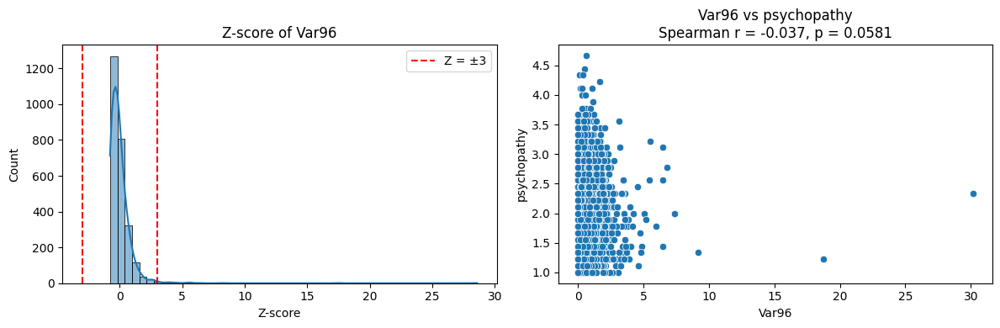

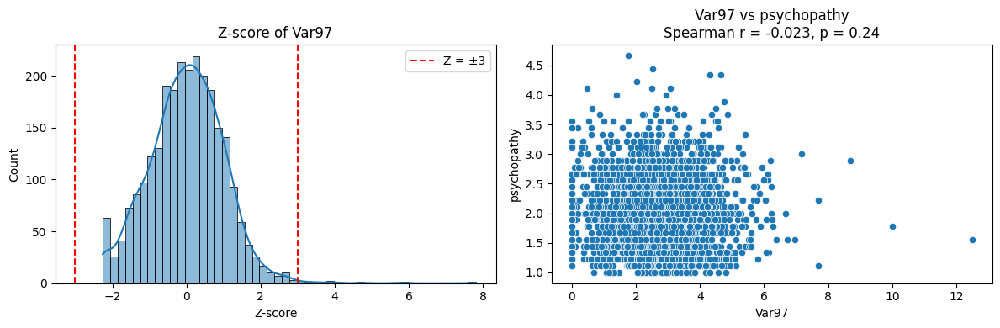

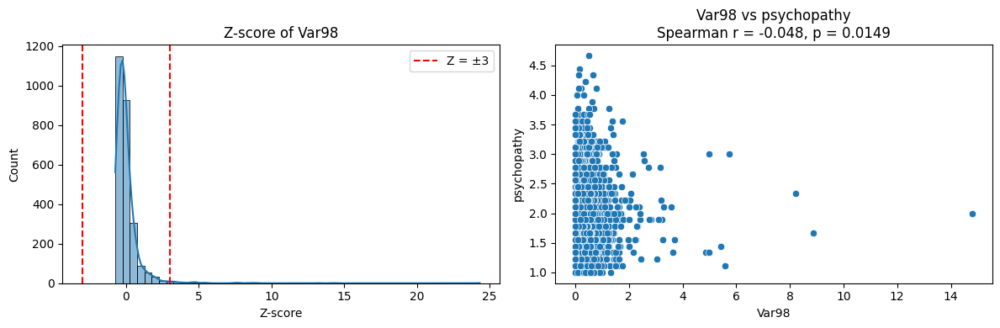

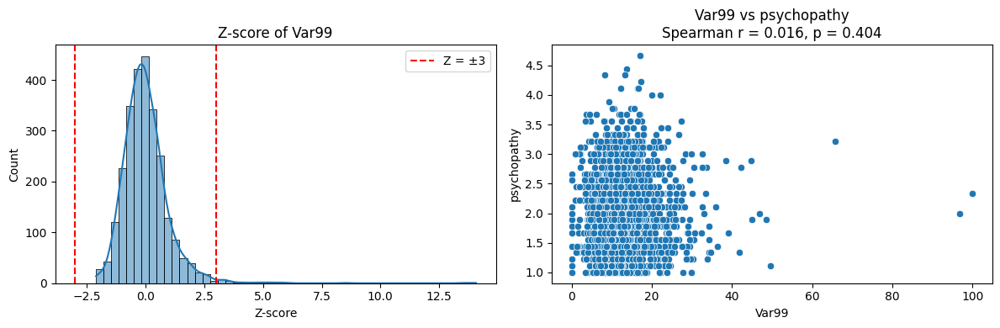

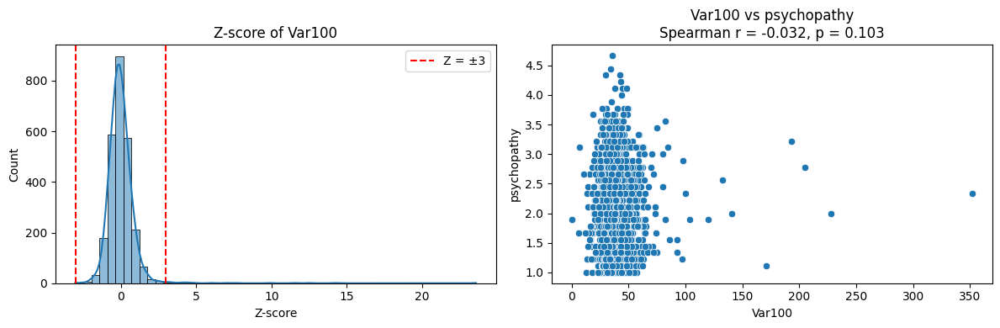

In [41]:
target = 'psychopathy'
features = data.drop(target, axis=1).columns

for feature in features:
    # 결측 제거된 동일 인덱스 기준으로 정렬
    valid_data = data[[feature, target]].dropna()

    # Z-score 계산
    z_scores = zscore(valid_data[feature])

    # 스피어만 상관계수 계산
    coef, p_val = spearmanr(valid_data[feature], valid_data[target])

    # Z-score Plot
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    sns.histplot(z_scores, kde=True, bins=50)
    plt.title(f"Z-score of {feature}")
    plt.xlabel("Z-score")
    plt.ylabel("Count")
    plt.axvline(x=3, color='red', linestyle='--', label='Z = ±3')
    plt.axvline(x=-3, color='red', linestyle='--')
    plt.legend()

    # Scatter Plot (feature vs target)
    plt.subplot(1, 2, 2)
    sns.scatterplot(x=valid_data[feature], y=valid_data[target])
    plt.title(f"{feature} vs {target}\nSpearman r = {coef:.3f}, p = {p_val:.3g}")
    plt.xlabel(feature)
    plt.ylabel(target)

    plt.tight_layout()
    plt.show()


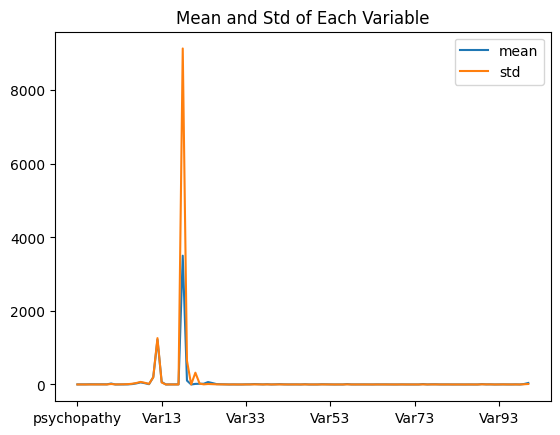

In [43]:
data.mean().plot(kind = 'line' , label = 'mean')
data.std().plot(kind = 'line' , label = 'std')
plt.legend()
plt.title("Mean and Std of Each Variable")
plt.show()

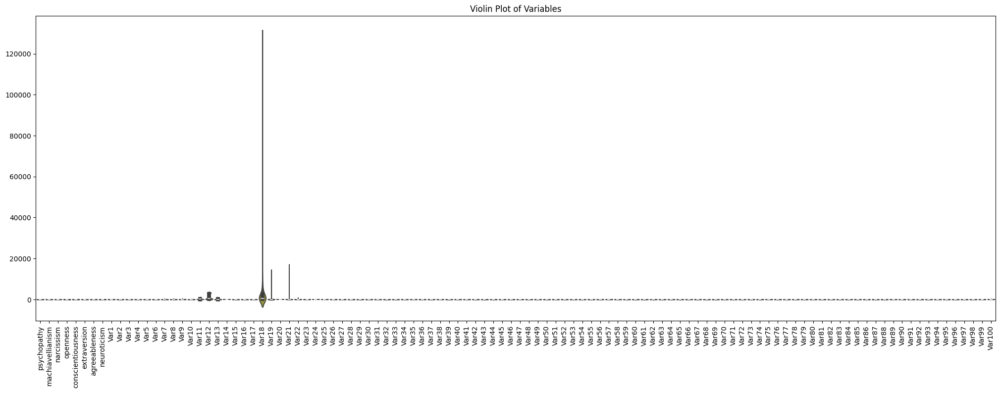

In [44]:
plt.figure(figsize = (25,8))
sns.violinplot(data = data)
plt.xticks(rotation = 90)
plt.title("Violin Plot of Variables")
plt.show()

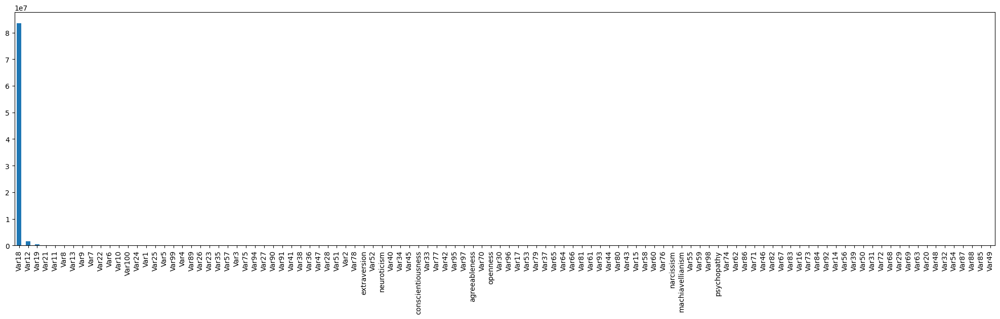

In [45]:
data.var().sort_values(ascending = False).plot(kind = 'bar' , figsize = (25,6))
plt.show()

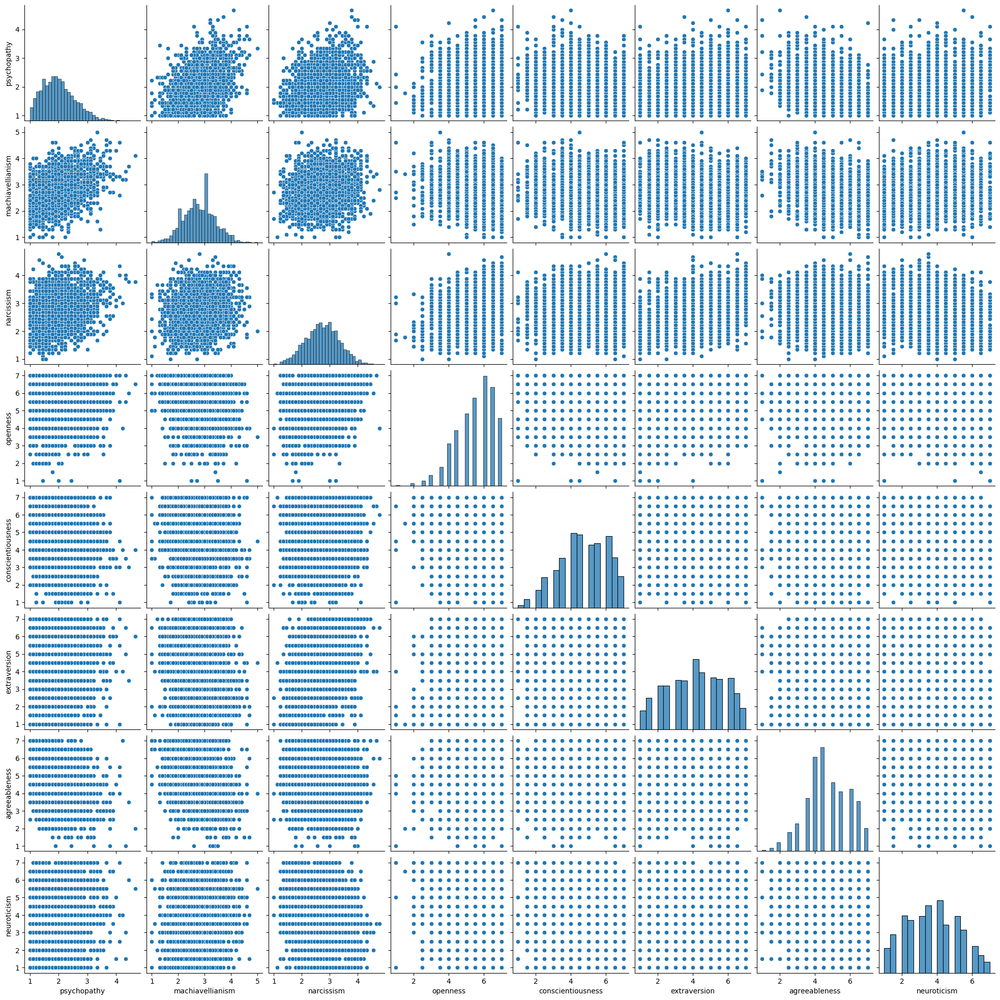

In [46]:
sns.pairplot(data.iloc[:, :8])
plt.show()

In [47]:
data = data.dropna(axis = 0)
data.drop_duplicates(inplace= True)

/tmp/ipython-input-47-2124138200.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop_duplicates(inplace= True)


In [48]:
corr = data.corr(numeric_only= True)

corr = corr.where(np.triu(np.ones(corr.shape), k=1).astype(bool)) # 상관행렬 대칭성 제거
corr.style.background_gradient(cmap='Blues')

/usr/local/lib/python3.11/dist-packages/pandas/io/formats/style.py:3807: RuntimeWarning: All-NaN slice encountered
  smin = np.nanmin(gmap) if vmin is None else vmin
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/style.py:3808: RuntimeWarning: All-NaN slice encountered
  smax = np.nanmax(gmap) if vmax is None else vmax


In [49]:
# 월크-샤피로 검정 : 정규성/비정규성 검토
from scipy.stats import shapiro

for c in data.columns:
  stats,p = shapiro(data[c]) # 컬럼 단위로 1차원 데이터 넣기

  result = "정규" if p > 0.05 else "비정규"

  print(f"{c}: 통계량 = {stats:.4f} , p:{p:.4f} > {result}" )

psychopathy: 통계량 = 0.9663 , p:0.0000 > 비정규
machiavellianism: 통계량 = 0.9968 , p:0.0000 > 비정규
narcissism: 통계량 = 0.9959 , p:0.0000 > 비정규
openness: 통계량 = 0.9323 , p:0.0000 > 비정규
conscientiousness: 통계량 = 0.9679 , p:0.0000 > 비정규
extraversion: 통계량 = 0.9653 , p:0.0000 > 비정규
agreeableness: 통계량 = 0.9734 , p:0.0000 > 비정규
neuroticism: 통계량 = 0.9707 , p:0.0000 > 비정규
Var1: 통계량 = 0.9277 , p:0.0000 > 비정규
Var2: 통계량 = 0.2102 , p:0.0000 > 비정규
Var3: 통계량 = 0.2714 , p:0.0000 > 비정규
Var4: 통계량 = 0.3454 , p:0.0000 > 비정규
Var5: 통계량 = 0.4544 , p:0.0000 > 비정규
Var6: 통계량 = 0.6187 , p:0.0000 > 비정규
Var7: 통계량 = 0.7293 , p:0.0000 > 비정규
Var8: 통계량 = 0.7980 , p:0.0000 > 비정규
Var9: 통계량 = 0.6826 , p:0.0000 > 비정규
Var10: 통계량 = 0.4148 , p:0.0000 > 비정규
Var11: 통계량 = 0.8457 , p:0.0000 > 비정규
Var12: 통계량 = 0.7883 , p:0.0000 > 비정규
Var13: 통계량 = 0.9176 , p:0.0000 > 비정규
Var14: 통계량 = 0.5751 , p:0.0000 > 비정규
Var15: 통계량 = 0.9895 , p:0.0000 > 비정규
Var16: 통계량 = 0.9973 , p:0.0003 > 비정규
Var17: 통계량 = 0.9951 , p:0.0000 > 비정규
Var18: 통계량 = 0.3855 , p:0.

In [50]:
# 스피어만 상관계수
from scipy.stats import spearmanr

spearman_scores = []
spearman_pvals = []

X = data.drop('psychopathy' , axis = 1)
y = data['psychopathy']

for col in X.columns:
  coef , p_val = spearmanr(X[col],y)
  spearman_scores.append(coef)
  spearman_pvals.append(p_val)

  print(f"{col} p:{p_val} spear : {coef}")

machiavellianism p:4.975639835123878e-107 spear : 0.4218325775444724
narcissism p:8.346363300806506e-45 spear : 0.27733487064750767
openness p:0.10424190247723641 spear : 0.032716977542666115
conscientiousness p:1.2221122125987857e-24 spear : -0.20422939505477233
extraversion p:9.452886925720853e-06 spear : 0.08904494657413721
agreeableness p:2.521392661608041e-88 spear : -0.38570697445704494
neuroticism p:3.032548391066683e-06 spear : 0.09383459433042964
Var1 p:0.008139330870860993 spear : 0.05326666644625711
Var2 p:0.0007550665345557849 spear : 0.06778070805190325
Var3 p:0.004816660851419674 spear : 0.056739790698144985
Var4 p:0.0009345551747073738 spear : 0.06659144661321524
Var5 p:0.0008521511855130996 spear : 0.06710846641484025
Var6 p:0.0005870150836954558 spear : 0.0691613512700661
Var7 p:0.000912997348919659 spear : 0.06672249595873209
Var8 p:0.01886975210984682 spear : 0.04727246228145632
Var9 p:3.248436132660103e-05 spear : 0.0835562584891629
Var10 p:1.350279320730844e-05 spe

In [51]:
Q1 = data.quantile(0.25)
Q3 = data.quantile(0.75)
IQR = Q3 - Q1

# 이상치 감지
is_outlier = (data < (Q1 - 1.5 * IQR)) | (data > (Q3 + 1.5 * IQR))

# 이상치 비율 확인
outlier_ratio = is_outlier.sum() / len(data)
pd.set_option('display.max_rows', None)

outlier_ratio.sort_values(ascending=False)


,0
Var5,0.188488
Var6,0.177544
Var4,0.165383
Var19,0.160113
Var21,0.150385
Var18,0.141467
Var10,0.126064
Var3,0.117957
Var76,0.100932
Var63,0.095257


1. 비정규 데이터가 많다.
2. 범주형 (수치 - 순서형 ) 데이터 -> 평균/표준 의미가 없음


=> 다른 이상치 제거 방법 or 범주형 제외

범주형 제외하면 사실상 z score 나 IQR 둘 다 가능.


<br>
순서형

- 8가지 심리지표
<br>

수치형 이산형

- var(답글 , 리트윗 , 팔로워 수, 특정 단어 사용 빈도)


<br>
순서형 -> 값 자체에 높고 낮음의 의미가 있음
<br>
이산형 -> 값 자체의 의미는 없음. 단지 분류

- 후보 1. 간격으로 판단한다.
  - 이산형이면 값들간 간격이 일정함. 단지 분류니까
  - 순서형일경우 이산형보다 세부적으로 나뉘어짐 즉, 간격이 일정하지 않을 가능성이 높다.
  - 간격의 기준은 어떻게 정할 것이냐? 절대적인 기준은 기준 설정부터 비합리적이다. 따라서 이를 보완하고자 값들간 간격을 하나하나 계산한 다음 오차로 판단하겠다.


- 후보 2. 정규성 / 비정규성으로 판단한다.
  - 이산형이면 비정규일 가능성이 높다.
  - 순서형이면 분포에도 정규성을 따른다.

- 후보 3. 고유값으로 판단한다.
  - 최소 21 - 46개다. 이건 기각



<결정>
- 후보 1.
  1. 고윳값 간 간격을 하나하나 비교한 다음 간격의 상대적 오차(변동성)을 계산한다.
  2. 오차가 값들 간에 거의 동일하다 -> 순서형으로 판단. 상대오차가 크다 -> 명목형으로 판단.
  3. 이후 보조적으로 정규성 검사와 시각화를 통하여 왜도/첨도 등을 보고 판단한다.

  4. 간격 오차 계산 (오차율의 기준은?)
    - 최대 오차는 평균 간격의 0.05 정도로 정한다.보통 정수형으로 이산형을 분류하기 때문이다.
  


- var 중 고유값이 5개 이하면 명목형으로 분류해 원핫 인코딩하고,
고유값이 20~1800개라도 값의 분포가 극단적으로 편향되어 있다면 명목형으로 보고 원핫이나 빈도 인코딩을 한다.
그 외의 분포가 고르고 정량적 의미가 있는 변수는 연속형으로 판단해 인코딩하지 않고 그대로 사용한다.




| 기준                   | 분류  | 인코딩 방식          |
| -------------------- | --- | --------------- |
| 고유값 5개 이하            | 명목형 | 원핫 인코딩          |
| 고유값 20\~1800 & 편향 심함 | 명목형 | 원핫 or 빈도/타겟 인코딩 |
| 고유값 20\~1800 & 분포 고름 | 정량형 | 인코딩 안 함         |






<br>

위 방법으로 해도 눈에 띄는 향상은 없었다.(0.36->0.37)

따라서 결측치 개수로 그룹화하는 방법은 어떨까?하는 내 가설이다.



<br>

8개 심리지표 , var14, var20 : 0개

var1-12 : 313개

var13-21 (14,20 제외) : 11개

var22-var100 : 327





| 기준                 | 의미                                    | 적용 방식                                 |
| ------------------ | ------------------------------------- | ------------------------------------- |
| 고유값 개수             | 명목형 vs 연속형 구분                         | 5개 이하 → one-hot, 20개 이상 → skewness 기준 |
| 분포의 편향 (top3 비율)   | 고유값이 많더라도 상위값이 몰려 있으면 → freq encoding |                                       |
| 시각화                | 연속성/이산성 판단                            | 비정형적 분포 → 수동 분류                       |
| **결측치 개수** (새로 제안) | **feature 정보의 밀도/신뢰도 분류**             | 값이 거의 없는 feature → 제거 or 별도 처리        |

  


In [52]:
def encode_strategy_selector(data,
                             low_cardinality_threshold=5,
                             high_cardinality_min=20,
                             skew_threshold=0.9,
                             verbose=False):
    onehot = []
    freq = []
    cont = []

    for col in data.columns:
        vals = data[col].dropna()
        unique_vals = vals.nunique()

        # 고유값 수가 작으면 명목형 → 원핫 인코딩
        if unique_vals <= low_cardinality_threshold:
            onehot.append(col)
            continue

        # 고유값 수가 많고, 편향 판단을 위한 분포 체크
        if unique_vals >= high_cardinality_min:
            value_counts = vals.value_counts(normalize=True).values
            top3_ratio = value_counts[:3].sum()

            if top3_ratio > skew_threshold:
                freq.append(col)
                continue
            else:
                cont.append(col)
                continue

        # 그 외 애매한 경우 → 기본적으로 연속형 취급
        cont.append(col)

    if verbose:
        print("원핫 인코딩 대상:", onehot)
        print("빈도/타겟 인코딩 대상:", freq)
        print("그대로 사용하는 연속형:", cont)

    return onehot, freq, cont


In [53]:
onehot, freq , cont = encode_strategy_selector(
    data,
    verbose= True
)

원핫 인코딩 대상: ['Var14', 'Var20']
빈도/타겟 인코딩 대상: ['Var2', 'Var3']
그대로 사용하는 연속형: ['psychopathy', 'machiavellianism', 'narcissism', 'openness', 'conscientiousness', 'extraversion', 'agreeableness', 'neuroticism', 'Var1', 'Var4', 'Var5', 'Var6', 'Var7', 'Var8', 'Var9', 'Var10', 'Var11', 'Var12', 'Var13', 'Var15', 'Var16', 'Var17', 'Var18', 'Var19', 'Var21', 'Var22', 'Var23', 'Var24', 'Var25', 'Var26', 'Var27', 'Var28', 'Var29', 'Var30', 'Var31', 'Var32', 'Var33', 'Var34', 'Var35', 'Var36', 'Var37', 'Var38', 'Var39', 'Var40', 'Var41', 'Var42', 'Var43', 'Var44', 'Var45', 'Var46', 'Var47', 'Var48', 'Var49', 'Var50', 'Var51', 'Var52', 'Var53', 'Var54', 'Var55', 'Var56', 'Var57', 'Var58', 'Var59', 'Var60', 'Var61', 'Var62', 'Var63', 'Var64', 'Var65', 'Var66', 'Var67', 'Var68', 'Var69', 'Var70', 'Var71', 'Var72', 'Var73', 'Var74', 'Var75', 'Var76', 'Var77', 'Var78', 'Var79', 'Var80', 'Var81', 'Var82', 'Var83', 'Var84', 'Var85', 'Var86', 'Var87', 'Var88', 'Var89', 'Var90', 'Var91', 'Var92', 'Var93', 

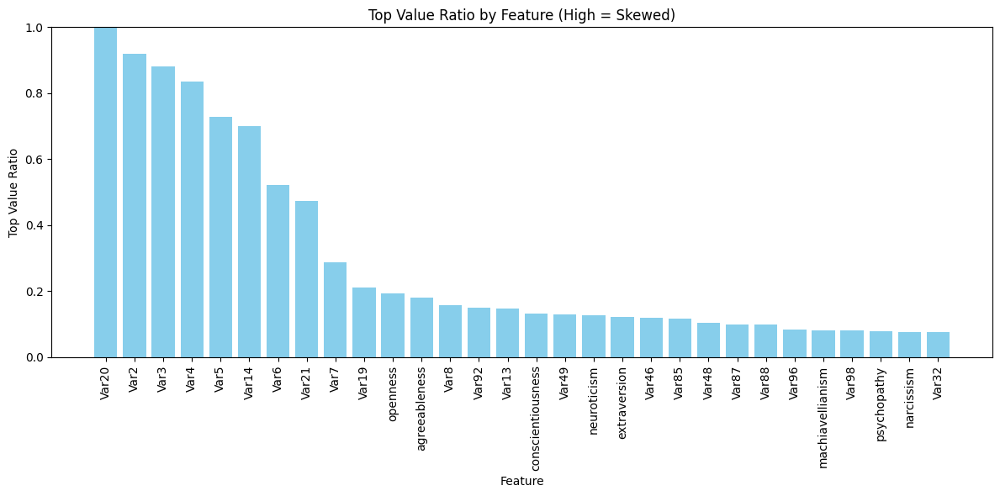

In [54]:
import pandas as pd
import matplotlib.pyplot as plt


# 시각화 함수: 각 변수의 최빈값 비율 시각화
def plot_extreme_skewness(data, top_k=30):
    skew_info = []
    for col in data.columns:
        if data[col].dtype in ['float64', 'int64'] and data[col].nunique() > 1:
            vc = data[col].value_counts(normalize=True, dropna=False)
            top_ratio = vc.iloc[0]
            skew_info.append((col, top_ratio, len(vc)))
    skew_df = pd.DataFrame(skew_info, columns=['Feature', 'TopValueRatio', 'UniqueCount'])
    skew_df = skew_df.sort_values(by='TopValueRatio', ascending=False).head(top_k)

    plt.figure(figsize=(12, 6))
    bars = plt.bar(skew_df['Feature'], skew_df['TopValueRatio'], color='skyblue')
    plt.xticks(rotation=90)
    plt.ylim(0, 1)
    plt.title('Top Value Ratio by Feature (High = Skewed)')
    plt.ylabel('Top Value Ratio')
    plt.xlabel('Feature')
    plt.tight_layout()
    plt.show()

plot_extreme_skewness(data)


In [55]:
df_cont = data[cont]
df_freq = data[freq]
df_onehot = data[onehot]

In [56]:
df_cont.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2467 entries, 0 to 2925
Columns: 104 entries, psychopathy to Var100
dtypes: float64(104)
memory usage: 2.0 MB


In [57]:
df_freq.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2467 entries, 0 to 2925
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Var2    2467 non-null   float64
 1   Var3    2467 non-null   float64
dtypes: float64(2)
memory usage: 57.8 KB


In [58]:
X = df_cont.drop('psychopathy',axis = 1)
y = df_cont['psychopathy']

z_score = X.apply(zscore)

mask = (z_score.abs() < 3).all(axis = 1)


X_clean = X[mask]
y_clean = y[mask]

print(f"제거 전 샘플 수: {len(data)}, 제거 후 샘플 수: {len(X_clean)}")

제거 전 샘플 수: 2467, 제거 후 샘플 수: 1593


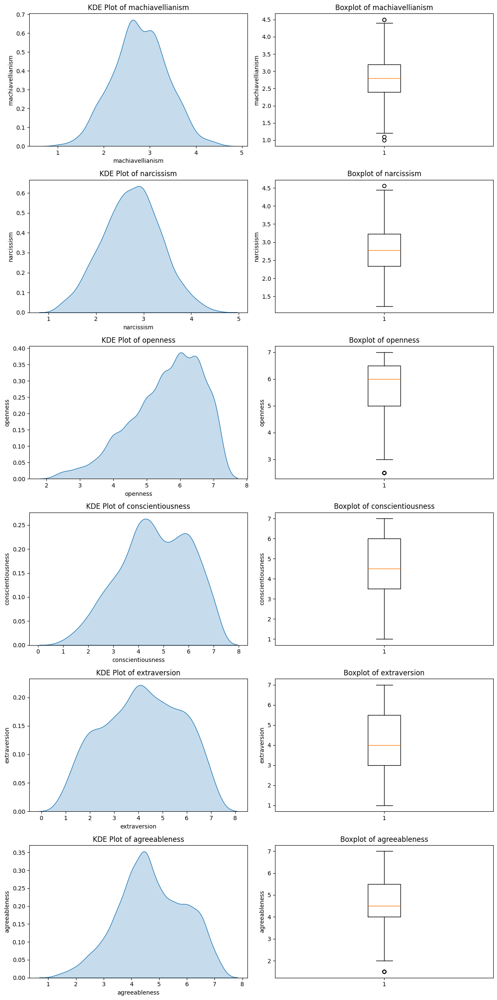

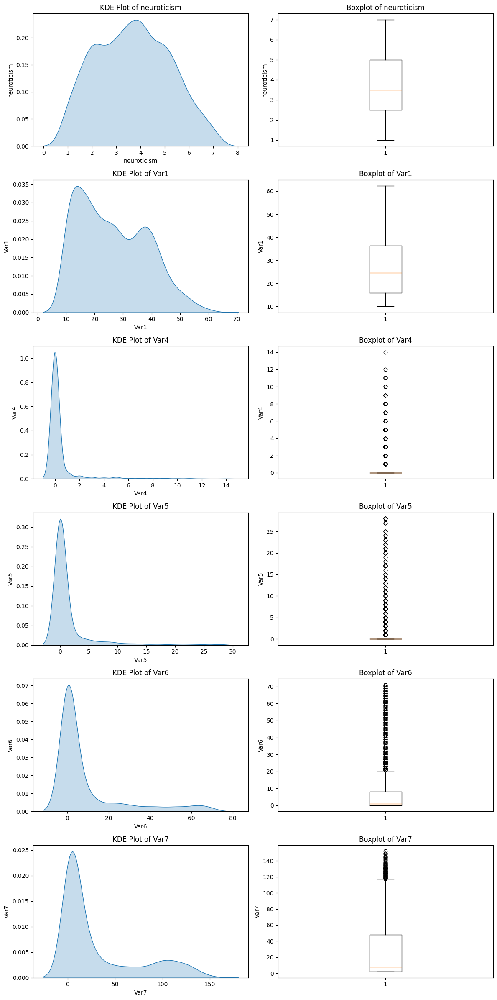

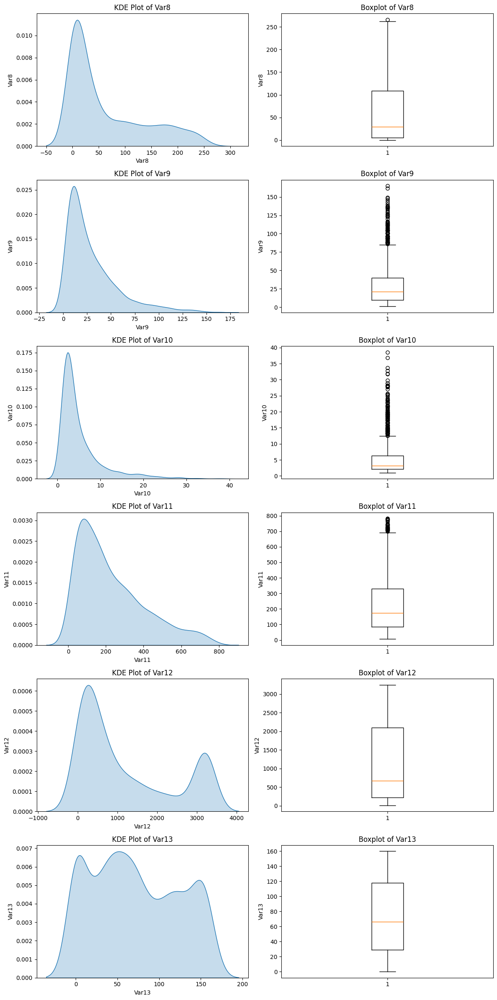

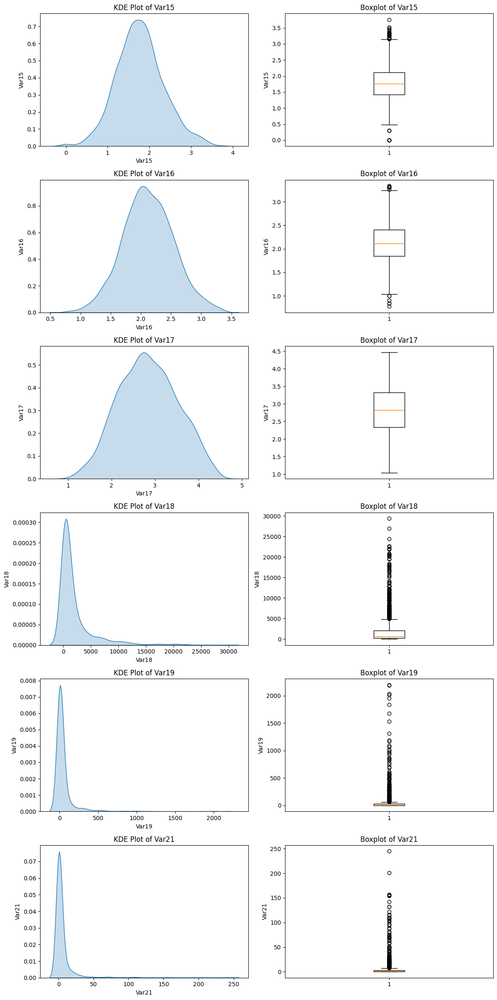

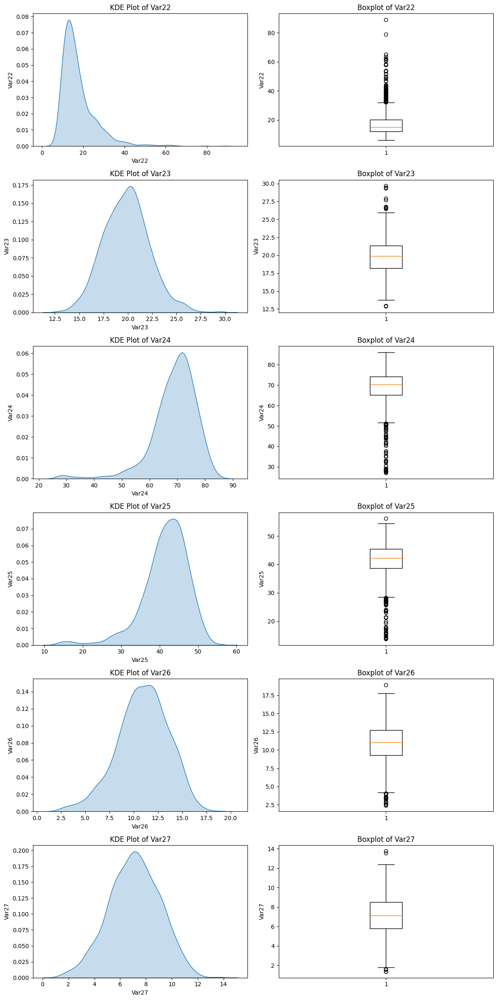

...

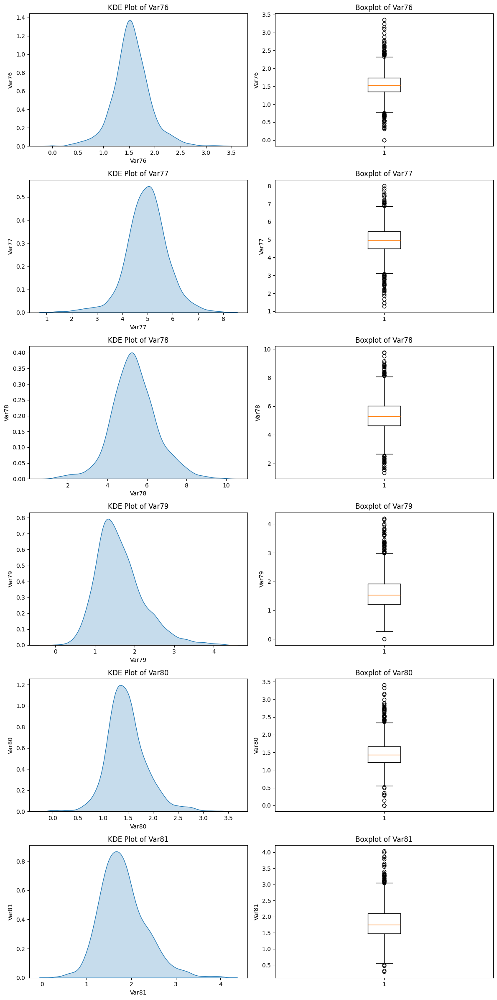

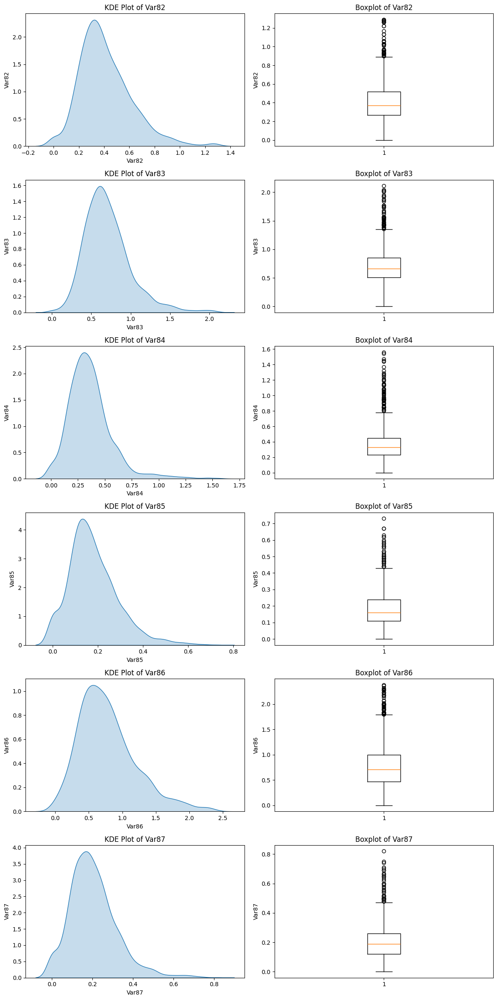

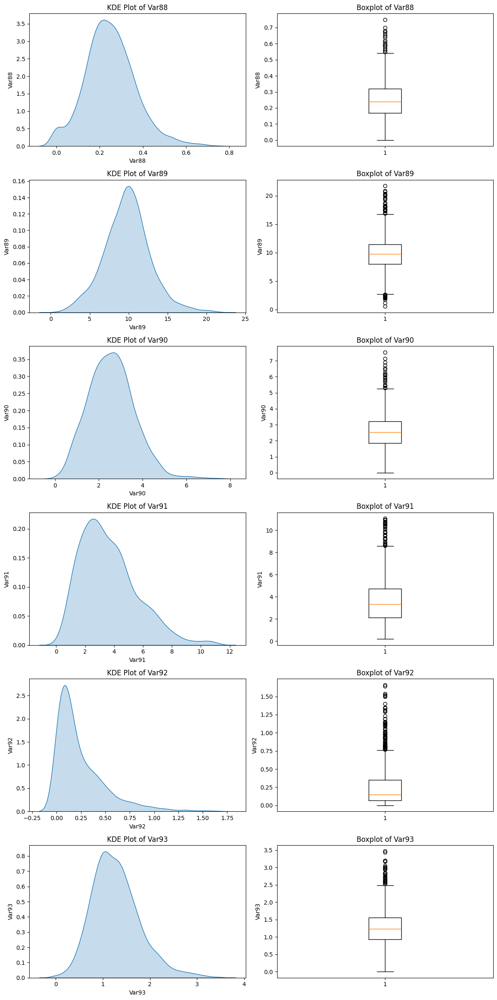

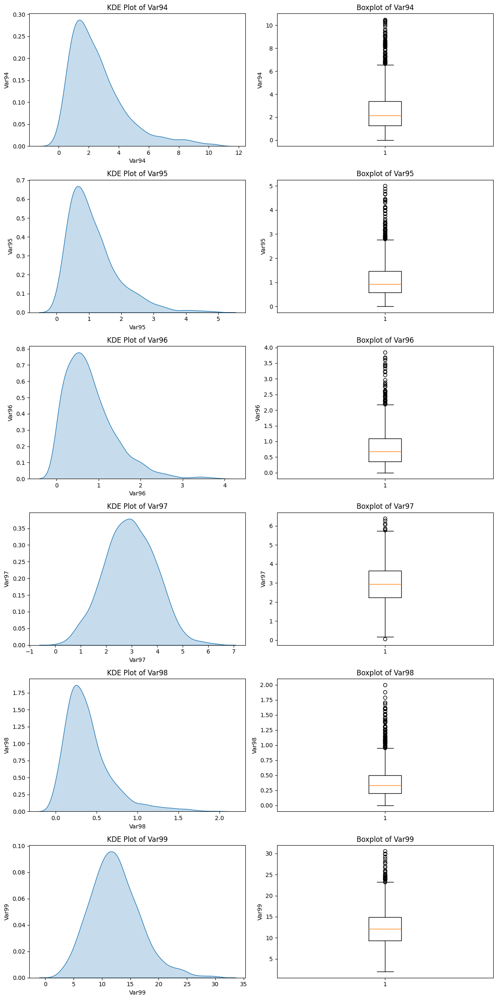

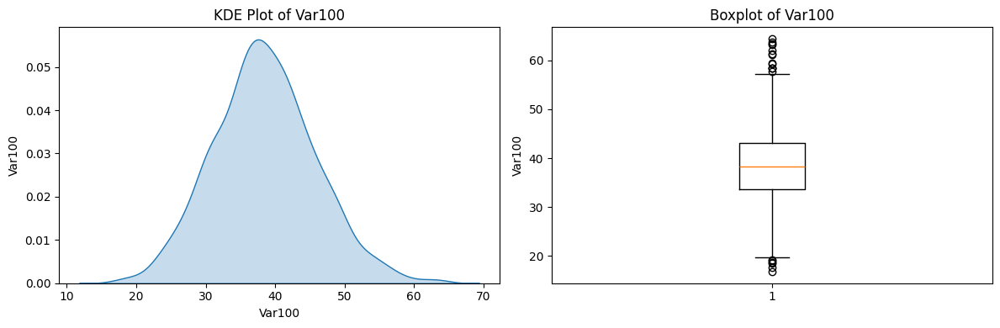

In [60]:
cols = X_clean.columns
cols_per_page = 6  # 한 페이지당 시각화할 변수 개수
num_pages = math.ceil(len(cols) / cols_per_page)

for i in range(num_pages):
    subset_cols = cols[i * cols_per_page : (i + 1) * cols_per_page]
    num_plots = len(subset_cols)

    fig, axs = plt.subplots(nrows=num_plots, ncols=2, figsize=(12, 4 * num_plots))

    if num_plots == 1:
        axs = [axs]  # 1개일 경우 [[ax1, ax2]] 형태로 변환

    for j, col in enumerate(subset_cols):
        sns.kdeplot(X_clean[col].dropna(), ax=axs[j][0], fill=True)
        axs[j][0].set_title(f'KDE Plot of {col}')
        axs[j][0].set_ylabel(col)

        axs[j][1].boxplot(X_clean[col].dropna())
        axs[j][1].set_title(f'Boxplot of {col}')
        axs[j][1].set_ylabel(col)

    plt.tight_layout()
    plt.show()


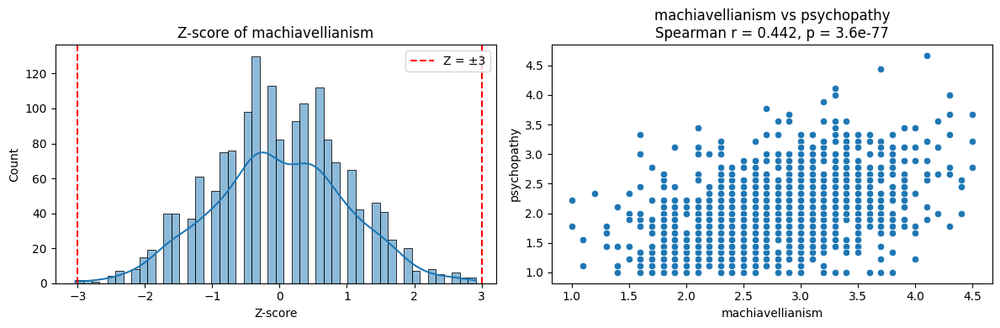

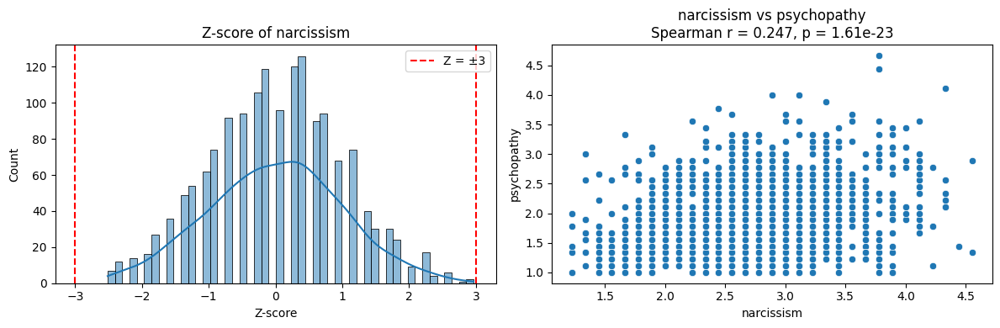

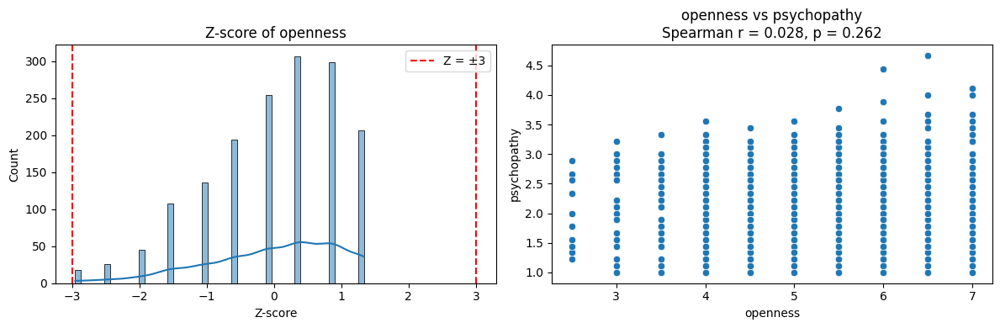

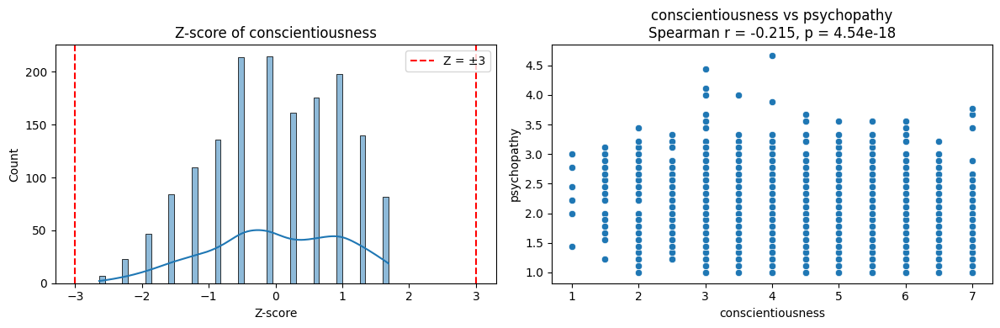

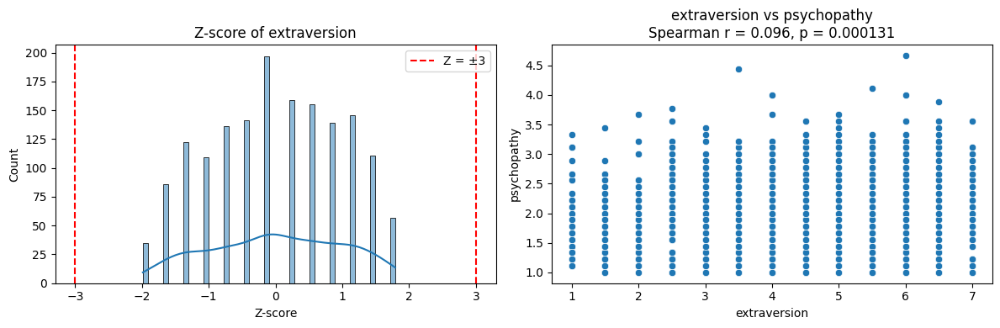

...

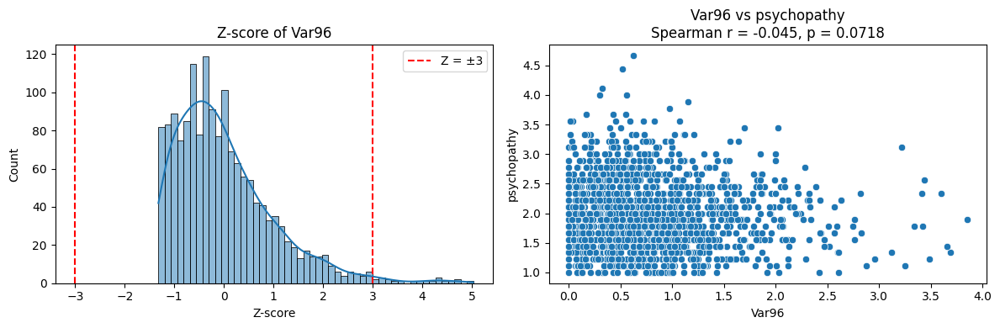

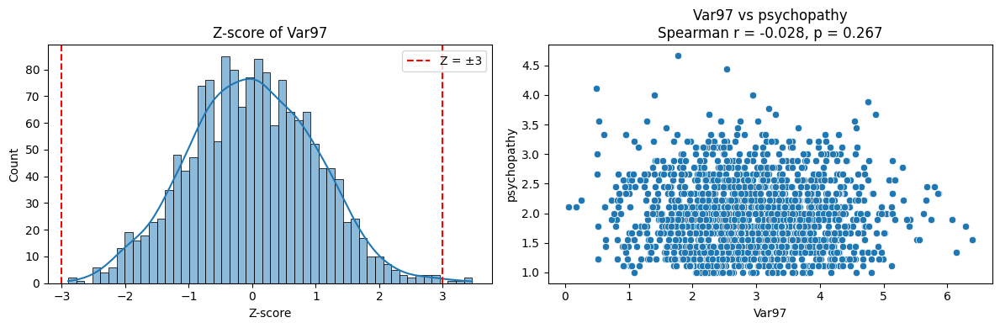

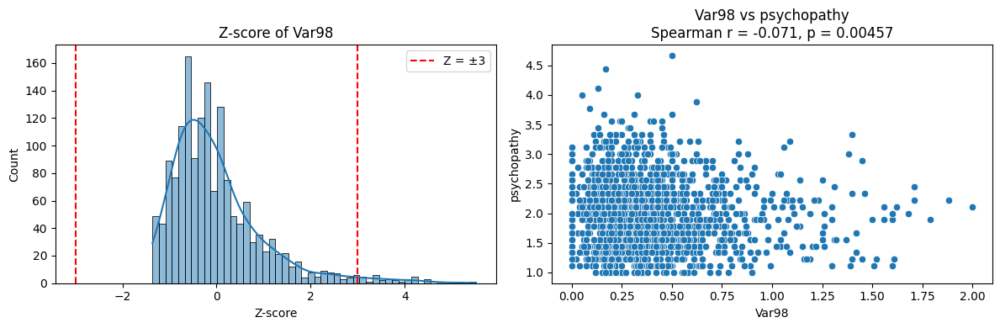

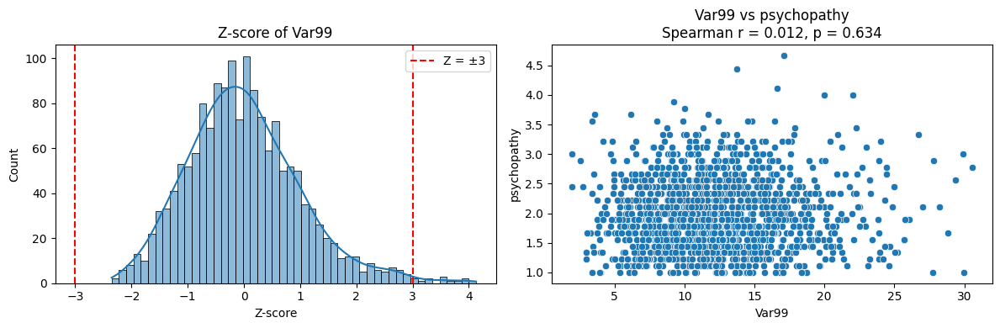

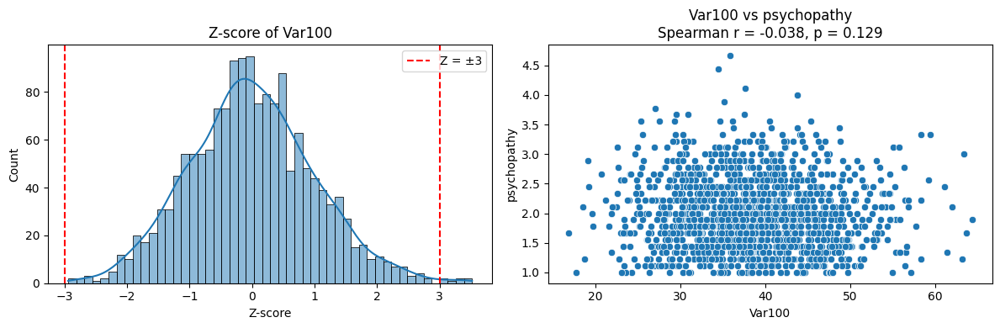

In [61]:
target = 'psychopathy'
features = X_clean.columns

for feature in features:
    # 결측 제거된 동일 인덱스 기준으로 정렬
    valid_data = X_clean[[feature]].dropna()
    valid_data[target] = y_clean

    # Z-score 계산
    z_scores = zscore(valid_data[feature])


    # 스피어만 상관계수 계산
    coef, p_val = spearmanr(valid_data[feature], valid_data[target])

    # Z-score Plot
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    sns.histplot(z_scores, kde=True, bins=50)
    plt.title(f"Z-score of {feature}")
    plt.xlabel("Z-score")
    plt.ylabel("Count")
    plt.axvline(x=3, color='red', linestyle='--', label='Z = ±3')
    plt.axvline(x=-3, color='red', linestyle='--')
    plt.legend()

    # Scatter Plot (feature vs target)
    plt.subplot(1, 2, 2)
    sns.scatterplot(x=valid_data[feature], y=valid_data[target])
    plt.title(f"{feature} vs {target}\nSpearman r = {coef:.3f}, p = {p_val:.3g}")
    plt.xlabel(feature)
    plt.ylabel(target)

    plt.tight_layout()
    plt.show()


In [62]:
for col in X_clean.columns:
  stats , p = shapiro(X_clean[col])
  result = "정규" if p > 0.05 else "비정규 "
  print(f"{col}: 통계량 = {stats:.4f} , p:{p:.4f} > {result}" )

machiavellianism: 통계량 = 0.9964 , p:0.0008 > 비정규 
narcissism: 통계량 = 0.9951 , p:0.0000 > 비정규 
openness: 통계량 = 0.9308 , p:0.0000 > 비정규 
conscientiousness: 통계량 = 0.9686 , p:0.0000 > 비정규 
extraversion: 통계량 = 0.9661 , p:0.0000 > 비정규 
agreeableness: 통계량 = 0.9720 , p:0.0000 > 비정규 
neuroticism: 통계량 = 0.9713 , p:0.0000 > 비정규 
Var1: 통계량 = 0.9471 , p:0.0000 > 비정규 
Var4: 통계량 = 0.3019 , p:0.0000 > 비정규 
Var5: 통계량 = 0.4094 , p:0.0000 > 비정규 
Var6: 통계량 = 0.5919 , p:0.0000 > 비정규 
Var7: 통계량 = 0.7227 , p:0.0000 > 비정규 
Var8: 통계량 = 0.8103 , p:0.0000 > 비정규 
Var9: 통계량 = 0.8151 , p:0.0000 > 비정규 
Var10: 통계량 = 0.7016 , p:0.0000 > 비정규 
Var11: 통계량 = 0.8975 , p:0.0000 > 비정규 
Var12: 통계량 = 0.8100 , p:0.0000 > 비정규 
Var13: 통계량 = 0.9315 , p:0.0000 > 비정규 
Var15: 통계량 = 0.9946 , p:0.0000 > 비정규 
Var16: 통계량 = 0.9985 , p:0.1677 > 정규
Var17: 통계량 = 0.9933 , p:0.0000 > 비정규 
Var18: 통계량 = 0.5794 , p:0.0000 > 비정규 
Var19: 통계량 = 0.3021 , p:0.0000 > 비정규 
Var21: 통계량 = 0.3322 , p:0.0000 > 비정규 
Var22: 통계량 = 0.7918 , p:0.0000 > 비정규 
Var23: 